# Dynamo MultiVelo

We integrated the rate estimation capabilities of Dynamo with the scATAC-seq computation capabilities of MultiVelo to develop Dynamo MultiVelo. And we use the embryonic E18 mouse brain from 10X Multiome as an example.

CellRanger output files can be downloaded from 10X website. Crucially, the filtered feature barcode matrix folder, ATAC peak annotations TSV, and the feature linkage BEDPE file in the secondary analysis outputs folder will be needed in this demo.

Quantified unspliced and spliced counts from Velocyto can be downloaded from [MultiVelo GitHub page](https://github.com/welch-lab/MultiVelo).

We provide the cell annotations for this dataset in “cell_annotations.tsv” on the GitHub page. (To download from GitHub, click on the file, then click “Raw” on the top right corner. If it opens in your browser, you can download the page as a text file.)



In [ ]:
import warnings
warnings.simplefilter('ignore', category=Warning)

import dynamo as dyn
import matplotlib.pyplot as plt
import muon as mu
import numpy as np
import os
import pandas as pd

In [2]:
dyn.configuration.set_figure_params('dynamo', background='white')
dyn.dynamo_logger.main_silence()

## Load data
Multi-omic data comes in one of two forms generally: (1) Matched data from multiple modaliies for each cell or (2) Unmatched data from different modalities for different cells.  The latter requires additional integration steps.  Here we'll demonstrate the matched case.  We'll provide another jupyter notebook for the (more time consuming) unmatched case.

The input data will be (one or two) 'outs' folders containing cellranger output and in parallel a velocyto directory containing the loom file of spliced and uncpliced reads as computed by velocyto.

***Note: This automatically reads in a loom file of splicing counts computed by velocyto.  We provide a separate notebook to download the relevant files from 10X genomics and count the spliced/unspliced reads.***

In [3]:
# Read in matched data
matched_mdata = dyn.multi.read_10x_multiome_h5(multiome_base_path='data/multi',
                                                       rna_splicing_loom='velocyto/10X_multiome_mouse_brain.loom',
                                                      cellranger_path_structure=False)

|-----> Deserializing MATCHED scATAC-seq and scRNA-seq data ...
|-----------> reading the multiome h5 file ...
Added `interval` annotation for features from data/multi/filtered_feature_bc_matrix.h5
|-----------------> <insert> .uns[matched_atac_rna_data] = True
|-----------------> <insert> path to fragments file in .uns['files'] ...
|-----------> adding peak annotation ...
|-----------> homogenizing cell indices ...
|-----------> adding splicing data ...
|-----------> aggregating peaks ...
|-----> CellRanger ARC identified as 1.0.0
|-----> Found 19006 genes with promoter peaks


100%|██████████| 19006/19006 [00:05<00:00, 3263.15it/s]


|-----> [read_10x_multiome_h5] completed [59.3573s]


## Pre-processing

Here we carry out preprocessing as specified in recipes in the manner carried out by dynamo.  Preprocessing of scATAC-seq data involves computing latent semantic indexing, followed by filtering of cells and peaks.  Preprocessing of scRNA-seq data uses functionality already build into dynamo.

In [4]:
# Instantiate a multi-omic preprocessor
multi_preprocessor = dyn.multi.MultiPreprocessor(cell_cycle_score_enable=False)

# Preprocess
multi_preprocessor.preprocess_mdata(matched_mdata,
                                    recipe_dict={'atac': 'muon', 'rna': 'monocle'})

|-----> Running muon preprocessing pipeline for scATAC-seq data ...


Reading Fragments: 100%|██████████| 1000000/1000000 [00:05<00:00, 184163.89it/s]


|-----------> filtered out 0 outlier features
|-----------> filtered out 98 outlier cells
|-----------> filtered out 96 outlier cells
|-----> computing TF-IDF
|-----> normalizing
|-----> feature selection
|-----------> identified 10827 highly variable features
|-----> computing latent sematic indexing
|-----------> <insert> X_lsi key in .obsm
|-----------> <insert> LSI key in .varm
|-----------> <insert> [lsi][stdev] key in .uns
|-----> [preprocess_atac_muon] completed [129.1015s]
|-----> Running monocle preprocessing pipeline...
|-----------> filtered out 4 outlier cells
|-----------> filtered out 23573 outlier genes
|-----> PCA dimension reduction
|-----> <insert> X_pca to obsm in AnnData Object.
|-----> [Preprocessor-monocle] completed [61.5856s]


## Integration

For matched data, integration is a trivial task - merely a matter of restricting the data to cell with data passing QC in all modalities.  For unmatched samples this is a harder problem for which we have implemented several solutions in the accompanying notebook.

In [39]:
integrated_matched_mdata = dyn.multi.integrate(mdata = matched_mdata,
                                     gtf_path = '/mnt/home/zehuazeng/data/gtf/GCF_000001635.27_GRCm39_genomic.gtf.gz')
integrated_matched_mdata.mod['aggr']=matched_mdata['aggr'][integrated_matched_mdata.obs.index]

In [48]:
integrated_matched_mdata.update()

In [57]:
integrated_matched_mdata.var_names_make_unique()

#### Checkpoint
A checkpoint serializing the integrated and preprocessed MuData object to cache.

In [59]:
integrated_matched_mdata.write(os.path.join('data/cache', 'integrated_matched_mdata.h5mu'))

In [3]:
import muon
integrated_matched_mdata=mu.read(os.path.join('data/cache', 'integrated_matched_mdata.h5mu'))
integrated_matched_mdata

MuData object with n_obs × n_vars = 4801 × 193182
  var:	'gene_ids', 'feature_types', 'genome', 'interval'
  3 modalities
    atac:	4248 x 141904
      obs:	'n_genes_by_counts', 'total_counts', 'nucleosome_signal', 'modality'
      var:	'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
      uns:	'atac', 'base_data_path', 'files', 'hvg', 'log1p', 'lsi', 'matched_atac_rna_data', 'pp'
      obsm:	'X_lsi'
      varm:	'LSI'
      layers:	'X_tfidf', 'counts'
    rna:	4248 x 32285
      obs:	'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'counts_Size_Factor', 'initial_counts_cell_size', 'ntr', 'modality'
      var:	'gene_ids', 'feature_types', 'genome', 'interval', 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'score', 'log_m', 'frac', 'use_for_pca', 'ntr'
      uns:	'PCs', 'base_data_path', 'explained_variance_ratio_', 'feature_selection', 'pca_mean', 'pp', 'velocyto_SVR'
      obsm:	'X_pca'
      layers:	'X_counts', 'X_spliced', 'X_unspliced', 'ambiguous', 'counts', 'matrix', 'spliced', 'unspliced'
    aggr:	4248 x 18993
      obs:	'n_genes_by_counts', 'total_counts'
      var:	'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
      uns:	'pp'

In [4]:
#if we read from h5mu, we need to set `.uns['pp']['tkey']` at first to avoid the error
integrated_matched_mdata['rna'].uns['pp']['tkey']=None

## Compute multi-omic velocity

We now proceed with the computation of multi-omic velocities.  Implemented are deterministic and stochastic computations.  The dynamical  models the kinetics of individual enhancers

MultiVelo incorporates chromatin accessibility information into RNA velocity and achieves better lineage predictions.

In [ ]:
adata_result=dyn.multi.multi_velocities(mdata=integrated_matched_mdata,
                                        core=10)

|-----> calculating first/second moments...
|-----? layer X_counts is not in any of the (['X_spliced', 'X_unspliced'], ['X_new', 'X_total'], ['X_uu', 'X_ul', 'X_su', 'X_sl']) groups, skipping...
|-----? layer X_counts is not in any of the (['X_spliced', 'X_unspliced'], ['X_new', 'X_total'], ['X_uu', 'X_ul', 'X_su', 'X_sl']) groups, skipping...
|-----? layer X_counts is not in any of the (['X_spliced', 'X_unspliced'], ['X_new', 'X_total'], ['X_uu', 'X_ul', 'X_su', 'X_sl']) groups, skipping...
|-----> [moments calculation] completed [32.8139s]
|-----> retrieve data for non-linear dimension reduction...
|-----> [UMAP] using X_pca with n_pca_components = 30
|-----> [UMAP] completed [8.5922s]
|-----> Start computing neighbor graph...
|-----------> X_data is None, fetching or recomputing...
|-----> fetching X data from layer:None, basis:pca
|-----> method arg is None, choosing methods automatically...
|-----------> method ball_tree selected
|-----> [calculating transition matrix via pearson 

  0%|          | 0/1980 [00:00<?, ?it/s]

2024-10-28 19:55:20.458748: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-28 19:55:20.485691: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-28 19:55:20.495550: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-28 19:55:21.972365: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-28 19:55:22.005572: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factor

|-----------> 3671 cells passed filter and will be used to compute trajectories.
|-----------> GMM: difference between means = 8.006193803264807, threshold = 4.419909477233887.
|-----------> GMM: weight of the second Gaussian = 0.44148587220347.
|-----------> GMM decides not partial.
|-----------> Slope: SSE on induction phase = 3.5379861249704003, SSE on repression phase = 0.070972002379625.
|-----------> Thickness of trajectory = 3.4292769557146654. Trajectory is normal.
|-----> predicted partial trajectory: True
|-----> predicted trajectory direction:on
|-----> predicted model: 1
|-----------> 3648 cells passed filter and will be used to compute trajectories.
|-----------> GMM: difference between means = 5.59075247879956, threshold = 4.854374885559082.
|-----------> GMM: weight of the second Gaussian = 0.6475473125928539.
|-----------> GMM decides not partial.
|-----------> Slope: SSE on induction phase = 0.3440769421893981, SSE on repression phase = 0.07564372894075277.
|----------

#### Checkpoint
A checkpoint serializing the multi-velocity AnnData object to cache.

In [30]:
adata_result.write(os.path.join('data/cache', 'multivelo_result_brain.h5mu'),
                   compression='gzip')

## Annotate cells

We provide the cell annotations for this dataset in “cell_annotations.tsv” on the GitHub page. (To download from GitHub, click on the file, then click “Raw” on the top right corner. If it opens in your browser, you can download the page as a text file.)

In [9]:
# Load cell annotations
cell_annot = pd.read_csv('data/multi/cell_annotations.tsv', sep='\t', index_col=0)
cell_annot.index=[i.split('-')[0] for i in cell_annot.index]
ret_index=list(set(cell_annot.index) & set(adata_result.obs.index))
cell_annot=cell_annot.loc[ret_index]
#integrated_matched_mdata1 = integrated_matched_mdata[cell_annot.index,:]


## Velocity projection

In order to visualize the velocity vectors, we need to project the high dimensional velocity vector of cells to lower dimension (although dynamo also enables you to visualize raw gene-pair velocity vectors, see below). The projection involves calculating a transition matrix between cells for local averaging of velocity vectors in low dimension. There are three methods to calculate the transition matrix, either kmc, cosine, pearson. kmc is our new approach to learn the transition matrix via diffusion approximation or an Itô kernel. cosine or pearson are the methods used in the original velocyto or the scvelo implementation. Kernels that are based on the reconstructed vector field in high dimension is also possible and maybe more suitable because of its and robustness and smoothness. We will show you how to do that in another tutorial soon!

In [14]:
adata_result1=adata_result[cell_annot.index]
adata_result1.obs['celltype']=cell_annot['celltype'].tolist()

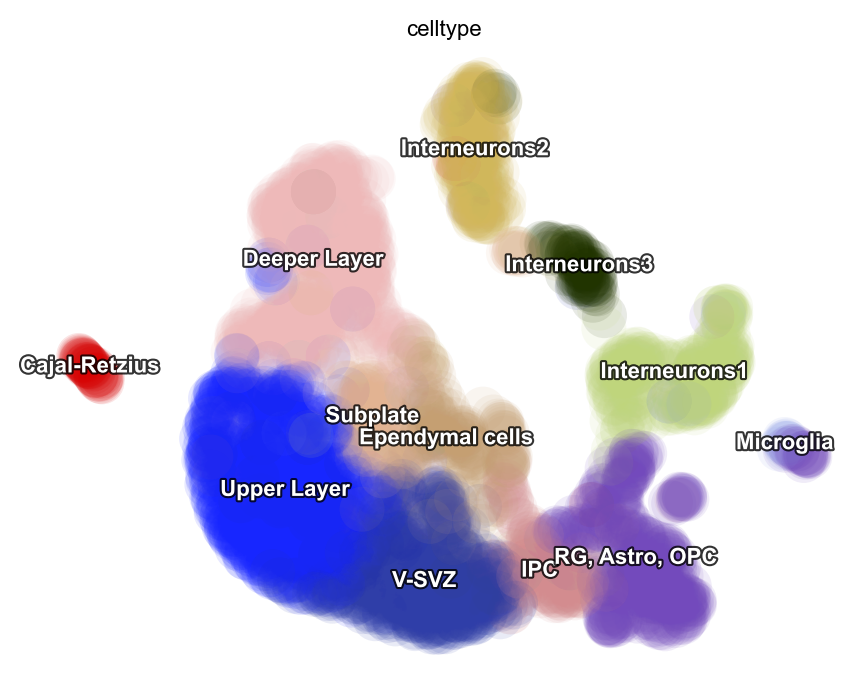

In [15]:
dyn.pl.umap(adata_result1, color='celltype')

In [25]:
if 'pearson_transition_matrix' in adata_result1.obsp.keys():
    del adata_result1.obsp['pearson_transition_matrix']
if 'velocity_umap' in adata_result1.obsm.keys():
    del adata_result1.obsm['velocity_umap']
transition_genes=adata_result1.var.loc[adata_result1.var['velo_s_norm_genes']==True].index.tolist()

In [27]:
dyn.tl.cell_velocities(adata_result1, vkey='velo_s',#layer='Ms',
                       X=adata_result1[:,transition_genes].layers['M_s'],
                       V=adata_result1[:,transition_genes].layers['velo_s'],
                       transition_genes=adata_result1.var.loc[adata_result1.var['velo_s_norm_genes']==True].index.tolist(),
                       method='pearson', 
                       other_kernels_dict={'transform': 'sqrt'}
                      )

|-----> [calculating transition matrix via pearson kernel with sqrt transform.] in progress: 100.0000%|-----> [calculating transition matrix via pearson kernel with sqrt transform.] completed [2.9534s]
|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%|-----> [projecting velocity vector to low dimensional embedding] completed [0.6861s]
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected


AnnData object with n_obs × n_vars = 3695 × 1971
    obs: 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'counts_Size_Factor', 'initial_counts_cell_size', 'ntr', 'modality', 'celltype'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'score', 'log_m', 'frac', 'use_for_pca', 'ntr', 'use_for_dynamics', 'use_for_transition', 'fit_alpha_c', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_sw1', 'fit_t_sw2', 'fit_t_sw3', 'fit_scale_cc', 'fit_rescale_c', 'fit_rescale_u', 'fit_alignment_scaling', 'fit_model', 'fit_direction', 'fit_loss', 'fit_likelihood', 'fit_likelihood_c', 'fit_ssd_c', 'fit_var_c', 'fit_c0', 'fit_u0', 'fit_s0', 'fit_anchor_min_idx', 'fit_anchor_max_idx', 'fit_anchor_velo_min_idx', 'fit_anchor_velo_max_idx', 'velo_s_genes', 'velo_u_genes', 'velo_chrom_genes', 'velo_s_norm

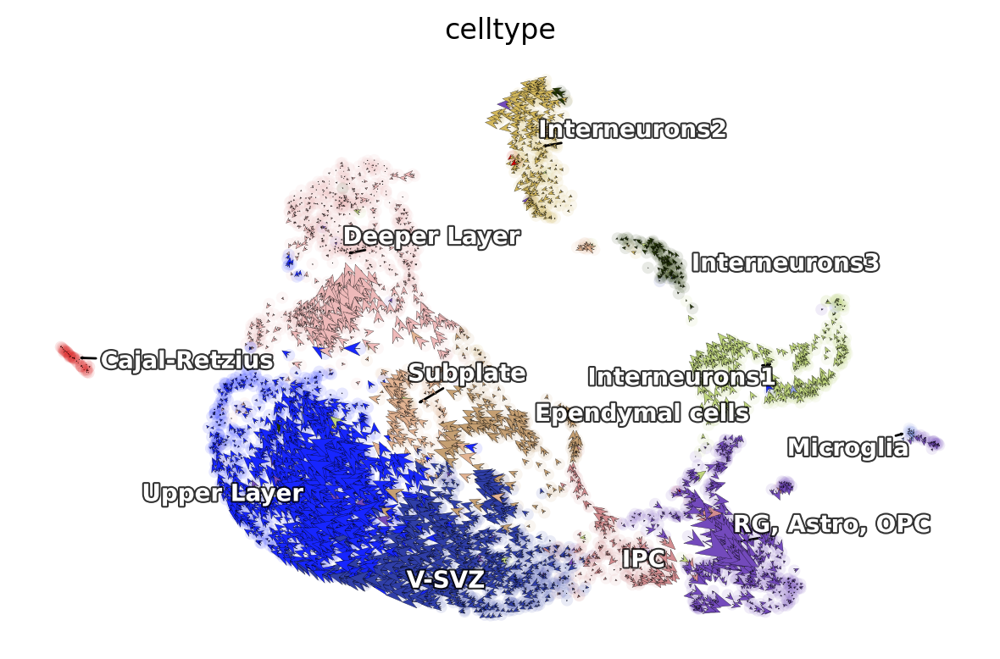

In [40]:
%matplotlib inline
dyn.pl.cell_wise_vectors(adata_result1, color=['celltype'],
                         basis='umap', show_legend='on data', 
                         s_kwargs_dict={'adjust_legend':True},
                         quiver_length=6, quiver_size=6, pointsize=0.1, 
                         show_arrowed_spines=False)

|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected


Text(0.5, 1.0, 'Dynamo MultiVelo')

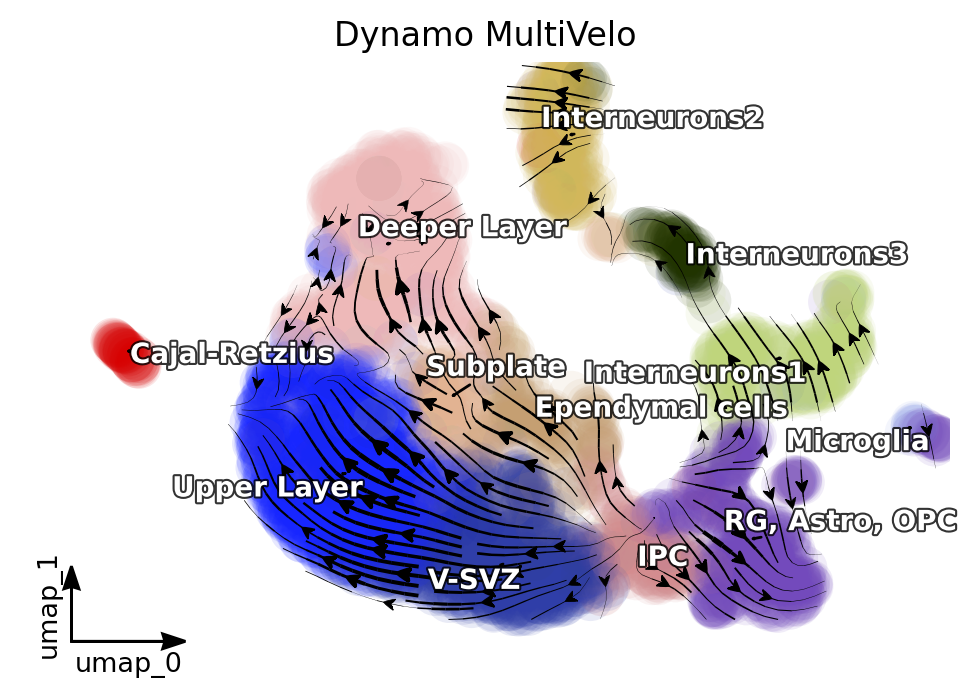

In [31]:
%matplotlib inline
dyn.pl.streamline_plot(adata_result1, color=['celltype'], 
                       #x='s',y='s',
                       #vkey='velo_s',ekey='Ms',#vector='velo_s_norm',
                       basis='umap', show_legend='on data',
                       s_kwargs_dict={'adjust_legend':True},
                       #title='Dynamo:Ms+Multi',
                       show_arrowed_spines=True,save_show_or_return='return')
plt.title('Dynamo MultiVelo')

Note that, if you pass x='gene_a', y='gene_b' to cell_wise_vectors, grid_vectors or streamline_plot, you can visualize the raw gene-pair velocity flows. gene_a and gene_b need to have velocity calculated (or use_for_dynamics in .var for those genes are True)

## Compare with Dynamo result without scATAC information

By comparing the results of Dynamo and Dynamo-Multi, we can see that the inclusion of scATAC-seq has corrected the erroneous differentiation pathway of the intermediate SVZ.


In [32]:
adata_rna=integrated_matched_mdata['rna'].copy()

In [36]:
adata_rna=adata_rna[cell_annot.index]
adata_rna.obs['celltype']=cell_annot['celltype'].tolist()

In [37]:
if 'pearson_transition_matrix' in adata_rna.obsp.keys():
    del adata_rna.obsp['pearson_transition_matrix']
if 'velocity_umap' in adata_rna.obsm.keys():
    del adata_rna.obsm['velocity_umap']

In [38]:
dyn.tl.cell_velocities(adata_rna, method='pearson', 
                       other_kernels_dict={'transform': 'sqrt'}
                      )

|-----> Start computing neighbor graph...
|-----------> X_data is None, fetching or recomputing...
|-----> fetching X data from layer:None, basis:pca
|-----> method arg is None, choosing methods automatically...
|-----------> method ball_tree selected
|-----> [calculating transition matrix via pearson kernel with sqrt transform.] in progress: 100.0000%|-----> [calculating transition matrix via pearson kernel with sqrt transform.] completed [4.9034s]
|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%|-----> [projecting velocity vector to low dimensional embedding] completed [0.6959s]
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected


AnnData object with n_obs × n_vars = 3695 × 32285
    obs: 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'counts_Size_Factor', 'initial_counts_cell_size', 'ntr', 'modality', 'celltype'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'score', 'log_m', 'frac', 'use_for_pca', 'ntr', 'use_for_dynamics', 'use_for_transition'
    uns: 'PCs', 'base_data_path', 'explained_variance_ratio_', 'feature_selection', 'pca_mean', 'pp', 'velocyto_SVR', 'vel_params_names', 'dynamics', 'neighbors', 'umap_fit', 'grid_velocity_umap'
    obsm: 'X_pca', 'X_umap', 'velocity_umap'
    varm: 'vel_params'
    layers: 'X_counts', 'X_spliced', 'X_unspliced', 'ambiguous', 'counts', 'matrix', 'spliced', 'unspliced', 'M_u', 'M_uu', 'M_s', 'M_us', 'M_ss', 'velocity_S'
    obsp: 'moments_con', 'distances', 'co

|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected


Text(0.5, 1.0, 'Dynamo Only RNA')

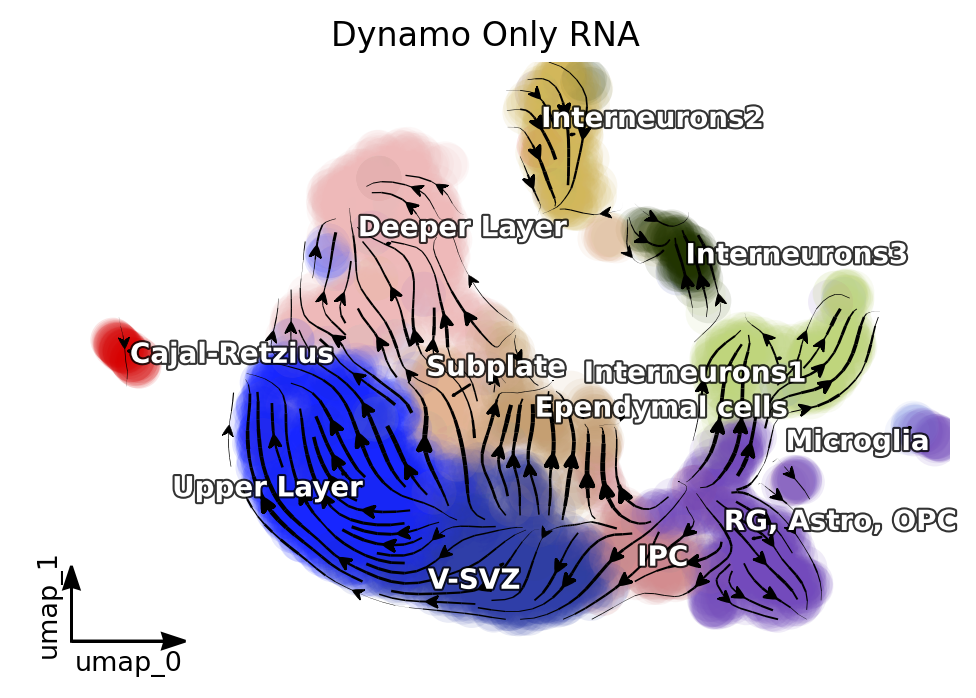

In [39]:
%matplotlib inline
dyn.pl.streamline_plot(adata_rna, color=['celltype'], 
                       #x='s',y='s',
                       #vkey='velo_s',ekey='Ms',#vector='velo_s_norm',
                       basis='umap', show_legend='on data',
                       s_kwargs_dict={'adjust_legend':True},
                       #title='Dynamo:Ms+Multi',
                       show_arrowed_spines=True,save_show_or_return='return')
plt.title('Dynamo Only RNA')

## Reconstruct vector field

In classical physics, including fluidics and aerodynamics, velocity and acceleration vector fields are used as fundamental tools to describe motion or external force of objects, respectively. In analogy, RNA velocity or protein accelerations estimated from single cells can be regarded as sparse samples in the velocity (La Manno et al. 2018) or acceleration vector field (Gorin, Svensson, and Pachter 2019) that defined on the gene expression space.

In general, a vector field can be defined as a vector-valued function f that maps any points (or cells’ expression state) x in a domain Ω with D dimension (or the gene expression system with D transcripts / proteins) to a vector y (for example, the velocity or acceleration for different genes or proteins), that is f(x) = y.

In [42]:
# you can set `verbose = 1/2/3` to obtain different levels of running information of vector field reconstruction
dyn.vf.VectorField(adata_result1, basis='umap', 
                   genes=transition_genes,
                   velocity_key='velo_s',
                   M=1000, pot_curl_div=True) 

|-----> VectorField reconstruction begins...
|-----> Retrieve X and V based on basis: UMAP. 
        Vector field will be learned in the UMAP space.
|-----> Generating high dimensional grids and convert into a row matrix.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----> [SparseVFC] completed [4.5722s]
|-----> Running ddhodge to estimate vector field based pseudotime in umap basis...
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected
|-----> Computing curl...


Calculating 2-D curl: 100%|██████████| 3695/3695 [00:00<00:00, 16171.14it/s]

|-----> Computing divergence...



Calculating divergence: 100%|██████████| 4/4 [00:00<00:00, 21.08it/s]


|-----> [VectorField] completed [18.2438s]


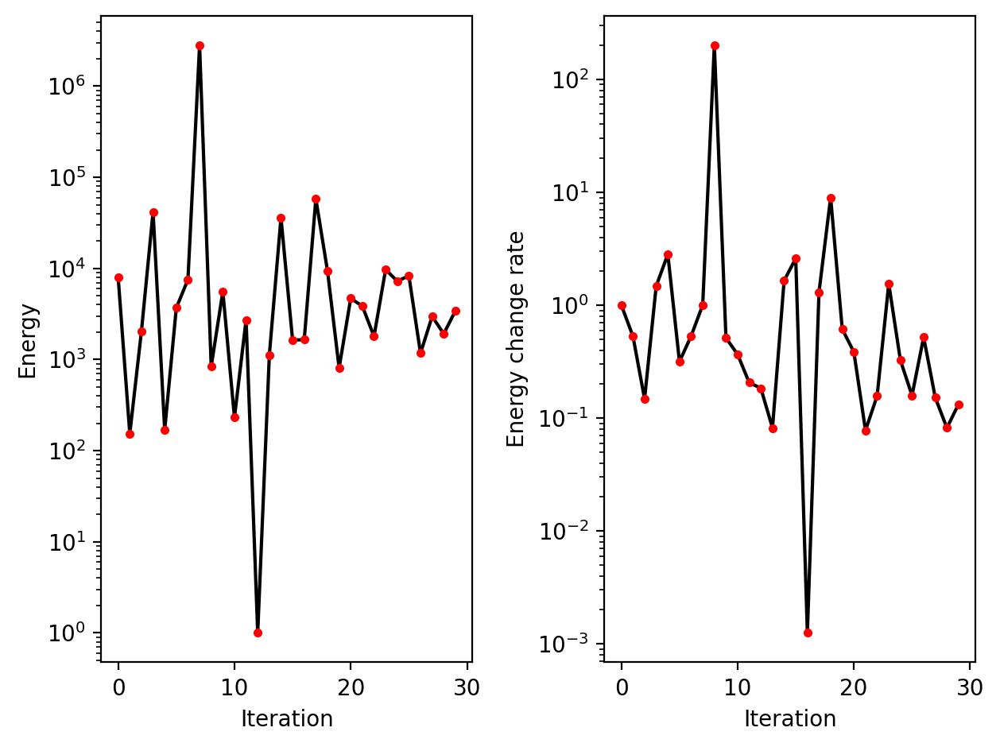

In [43]:
dyn.pl.plot_energy(adata_result1, basis='umap') 

## Characterize vector field topology

Since we learn the vector field function of the data, we can then characterize the topology of the full vector field space. For example, we are able to identify

- the fixed points (attractor/saddles, etc.) which may corresponds to terminal cell types or progenitors;

- nullcline, separatrices of a recovered dynamic system, which may formally define the dynamical behaviour or the boundary of cell types in gene expression space.

|-----> Vector field for umap is but its topography is not mapped. Mapping topography now ...
|-----> method arg is None, choosing methods automatically...
|-----------> method kd_tree selected


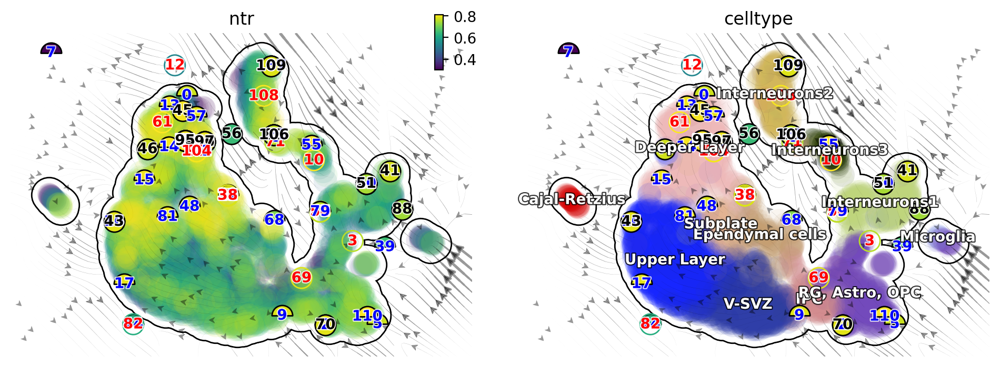

In [45]:
dyn.pl.topography(adata_result1, basis='umap', background='white', 
                  color=['ntr', 'celltype'], streamline_color='black',
                  show_legend='on data', frontier=True)

Single cell potential (In fact, it is the negative of potential here for the purpose to match up with the common usuage of pseudotime so that small values correspond to the progenitor state while large values terminal cell states.) estimated by dynamo can be regarded as a replacement of pseudotime. Since dynamo utilizes velocity which consists of direction and magnitude of cell dynamics, potential should be more relevant to real time and intrinsically directional (so you don’t need to orient the trajectory).

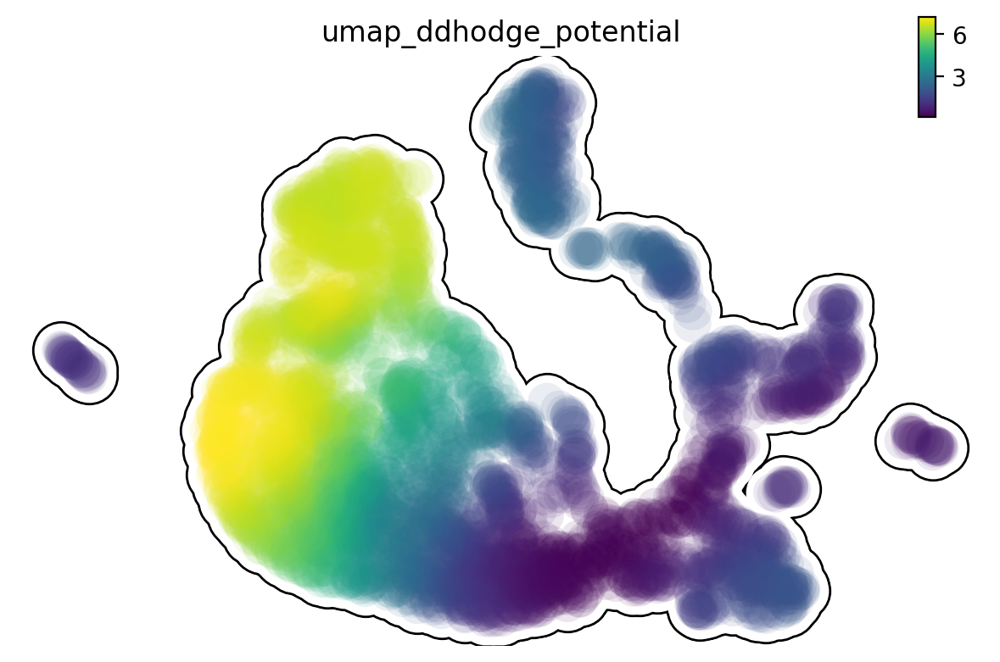

In [46]:
dyn.pl.umap(adata_result1,  
            color='umap_ddhodge_potential',
            frontier=True)

In [49]:
adata_result1

AnnData object with n_obs × n_vars = 3695 × 1971
    obs: 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'counts_Size_Factor', 'initial_counts_cell_size', 'ntr', 'modality', 'celltype', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'score', 'log_m', 'frac', 'use_for_pca', 'ntr', 'use_for_dynamics', 'use_for_transition', 'fit_alpha_c', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_sw1', 'fit_t_sw2', 'fit_t_sw3', 'fit_scale_cc', 'fit_rescale_c', 'fit_rescale_u', 'fit_alignment_scaling', 'fit_model', 'fit_direction', 'fit_loss', 'fit_likelihood', 'fit_likelihood_c', 'fit_ssd_c', 'fit_var_c', 'fit_c0', 'fit_u0', 'fit_s0', 'fit_anchor_min_idx',

In [54]:
len(list(set(fig3_si5)))

11

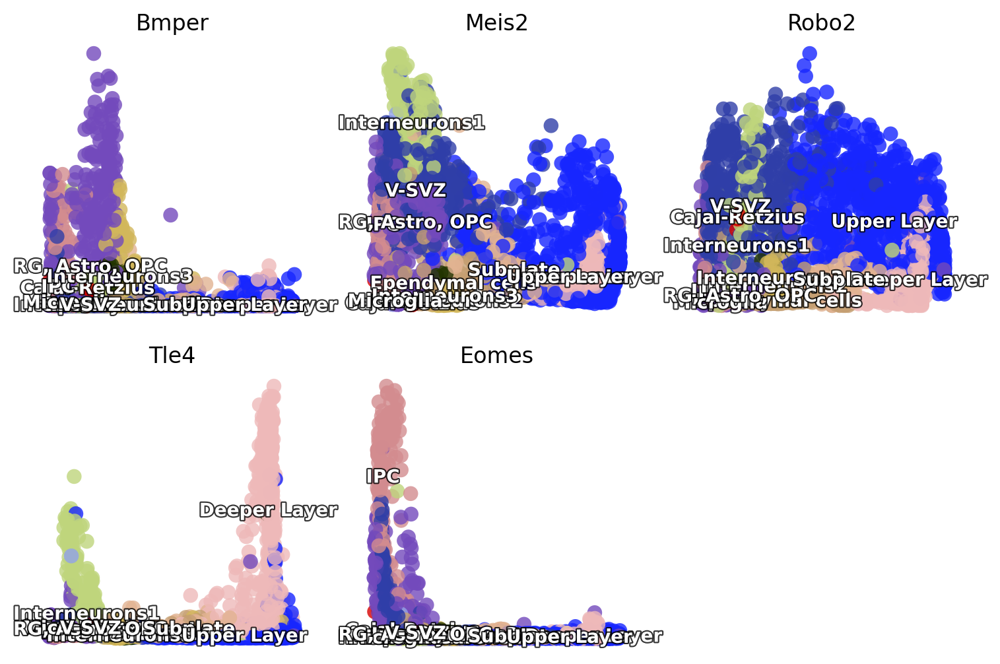

In [69]:
import numpy as np 
import matplotlib.pyplot as plt

fig3_si5 = ["Eomes", "Tle4", "Gria2",'Bmper', 'Robo2', 'Meis2', 
            'Grin2b',"Igfbpl1",]
fig3_si5=list(set(fig3_si5) & set(adata_result1.var_names))

fig,axes=plt.subplots(2,3,figsize = (9,6))
for i,(ax,gene) in enumerate(zip(axes.flatten(),fig3_si5)):
    ax=dyn.pl.scatters(adata_result1, x='umap_ddhodge_potential', 
                    pointsize=0.25, alpha=0.8, y=gene, layer='X_spliced', color='celltype',
                    background='white', ax=ax,
                    save_show_or_return='return',show_legend='on data',)
fig.delaxes(axes[1, 2])   
plt.show()

## Animate fate transition

Before we go, let us have some fun with animating cell fate commitment predictions via reconstructed vector field function. This cool application hopefully will also convince you that vector field reconstruction can enable some amazing analysis that is hardly imaginable before. With those and many other possibilities in single cell genomics, the prospect of biology to finally become a discipline as qualitative as physics and mathematics has never been so promising!

In [71]:
progenitor = adata_result1.obs_names[adata_result1.obs.celltype.isin(['IPC'])]
len(progenitor)

164

In [ ]:
dyn.pd.fate(adata_result1, basis='umap', init_cells=progenitor, 
            interpolation_num=100,  direction='forward',
           inverse_transform=False, average=False, cores=3)

In [74]:
%%capture
fig, ax = plt.subplots()
ax = dyn.pl.topography(adata_result1, color='celltype', 
                       ax=ax, save_show_or_return='return')

In [75]:
%%capture
instance = dyn.mv.StreamFuncAnim(adata=adata_result1, color='celltype', ax=ax)

In [76]:
%matplotlib notebook
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**32 # Ensure all frames will be embedded. 

from matplotlib import animation
import numpy as np 

anim = animation.FuncAnimation(instance.fig, instance.update, init_func=instance.init_background,
                               frames=np.arange(100), interval=100, blit=True)
plt.show()

In [77]:
from IPython.core.display import display, HTML
HTML(anim.to_jshtml()) # embedding to jupyter notebook.